<a href="https://colab.research.google.com/github/chuery/israelpalestinenews/blob/main/Final_analyses_visualizations_(updated_3_16.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from textblob import TextBlob
import datetime
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.pipeline import make_pipeline

In [ ]:
nyt_df = pd.read_csv("headlines_sorted-2.csv")
guardian_df = pd.read_csv("guardian_headlines_sorted.csv")

# World Leaders Sentiment Analysis

Analysis of Netanyahu, Biden, Trump, and Hamas in NYT vs. The Guardian.

[nltk_data] Downloading package vader_lexicon to /root/nltk_data...
[nltk_data]   Package vader_lexicon is already up-to-date!


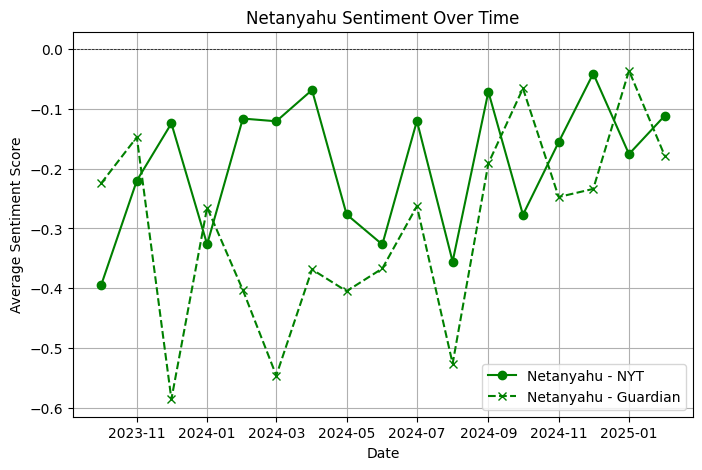

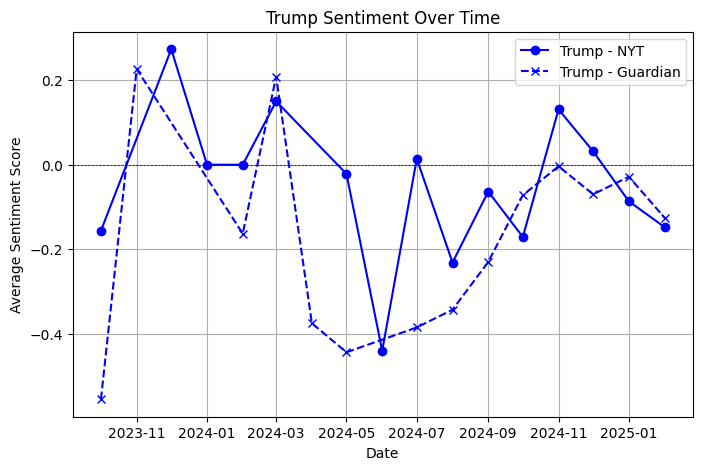

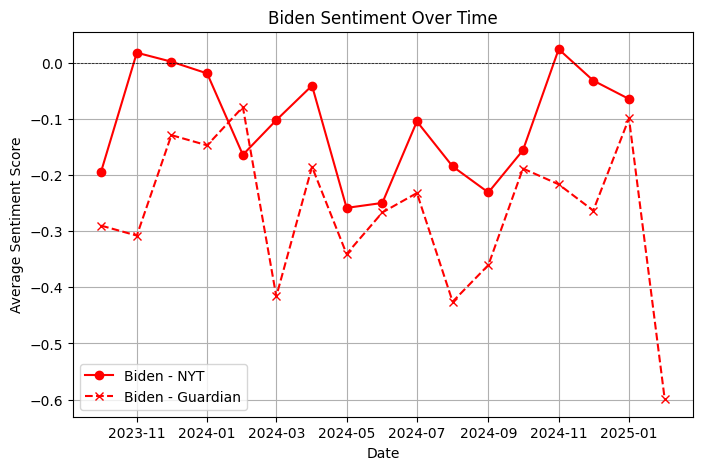

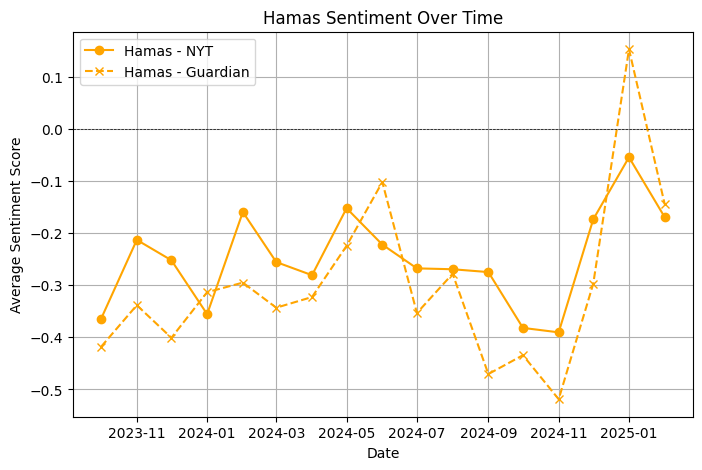

In [ ]:
!pip install nltk
import nltk
nltk.download('vader_lexicon')
import pandas as pd
from nltk.sentiment import SentimentIntensityAnalyzer
import matplotlib.pyplot as plt

sia = SentimentIntensityAnalyzer()

def get_sentiment_score(headline):
    return sia.polarity_scores(str(headline))["compound"]

# Check if a headline mentions any specific keywords (used to detect leader mentions)
def mentions_person_or_group(headline, keywords):
    headline_lower = str(headline).lower()
    return any(keyword in headline_lower for keyword in keywords)

# Define keywords for each leader
keywords_dict = {
    "Netanyahu": ['netanyahu'],
    "Trump": ['trump'],
    "Biden": ['biden'],
    "Hamas": ['hamas']
}

# Process each dataframe (date format, check for mentions of leaders, apply sentiment analysis)
def process_data(df):
    df = df.copy()
    df["Date"] = pd.to_datetime(df["Date"])

    processed_data = {}

    for person, keywords in keywords_dict.items():
        # Identify mentions of leaders
        df.loc[:, person + "_Mentions"] = df["Headline"].apply(lambda x: mentions_person_or_group(x, keywords))

        # Filter only relevant rows
        filtered_df = df[df[person + "_Mentions"]].copy()
        filtered_df["Date"] = filtered_df["Date"].dt.tz_localize(None)  # Remove timezone
        filtered_df.loc[:, "Month"] = filtered_df["Date"].dt.to_period("M")  # Convert to period

        # Apply sentiment analysis
        filtered_df.loc[:, person + "_Sentiment"] = filtered_df["Headline"].apply(get_sentiment_score)

        # Resample sentiment by month
        filtered_df.loc[:, 'Month'] = filtered_df["Date"].dt.to_period('M')
        average_sentiment_by_month = filtered_df.groupby('Month')[person + "_Sentiment"].mean()

        # Convert to datetime format
        average_sentiment_by_month.index = average_sentiment_by_month.index.to_timestamp()

        # Store results
        processed_data[person] = average_sentiment_by_month

    return processed_data

# Apply processing function to NYT and Guardian df
nyt_processed_data = process_data(nyt_df)
guardian_processed_data = process_data(guardian_df)

# Define colors and leaders
persons = ['Netanyahu', 'Trump', 'Biden', 'Hamas']
colors = ['green', 'blue', 'red', 'orange']

# Create individual plots and save them
for i, person in enumerate(persons):
    plt.figure(figsize=(8, 5))  # Set figure size

    # NYT sentiment
    if not nyt_processed_data[person].empty:
        plt.plot(nyt_processed_data[person].index, nyt_processed_data[person],
                 label=f'{person} - NYT', color=colors[i], linestyle='-', marker='o')

    # Guardian sentiment
    if not guardian_processed_data[person].empty:
        plt.plot(guardian_processed_data[person].index, guardian_processed_data[person],
                 label=f'{person} - Guardian', color=colors[i], linestyle='--', marker='x')

    # Labels and formatting
    plt.title(f'{person} Sentiment Over Time')
    plt.xlabel('Date')
    plt.ylabel('Average Sentiment Score')
    plt.axhline(y=0, color='black', linestyle='--', linewidth=0.5)  # Neutral sentiment line
    plt.legend()
    plt.grid(True)

    # Save the figure in high quality
    plt.savefig(f'sentiment_{person}.png', dpi=300, bbox_inches='tight')


# Set up KMeans Model

In [ ]:
import nltk
nltk.download('punkt_tab')
nltk.download('stopwords')
nltk.download('wordnet')

[nltk_data] Downloading package punkt_tab to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt_tab.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...


True

In [ ]:
# remove keywords used for scraping so that results will be more pertinent
def remove_keywords(text):
    keywords = ["Palestine", "Israel Palestine", "Palestinians", "Israel", "IDF", "Hamas", "Gaza",]
    for word in keywords:
        text = text.replace(word, "")
    return " ".join(text.split())

nyt_df["Headline"] = nyt_df["Headline"].apply(remove_keywords)
guardian_df["Headline"] = guardian_df["Headline"].apply(remove_keywords)


Clean data, apply TFIDF, and train kMeans model (k=7) for unsupervised learning.

In [ ]:
import numpy as np
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.pipeline import make_pipeline

# Initialize stopwords and lemmatizer
stop_words = set(stopwords.words('english'))
lemmatizer = WordNetLemmatizer()

# Define custom tokenizer function
def preprocess(text):
    tokens = word_tokenize(text.lower())  # Tokenization & lowercasing
    tokens = [lemmatizer.lemmatize(word) for word in tokens if word.isalnum()]  # Lemmatization & remove punctuation
    tokens = [word for word in tokens if word not in stop_words]  # Remove stopwords
    return ' '.join(tokens)

# apply preprocessing steps to NYT and Guardian
nyt_df["cleaned_Headline"] = nyt_df["Headline"].apply(preprocess)
guardian_df["cleaned_Headline"] = guardian_df["Headline"].apply(preprocess) # Added the preprocess function call here

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer

# NYT clustering
vec_nyt = TfidfVectorizer()
tfidf_nyt = vec_nyt.fit_transform(nyt_df["cleaned_Headline"])
model_nyt = KMeans(n_clusters=7, random_state=42)
model_nyt.fit(tfidf_nyt)
nyt_df["cluster"] = model_nyt.predict(tfidf_nyt)

# Guardian clustering
vec_guardian = TfidfVectorizer()
tfidf_guardian = vec_guardian.fit_transform(guardian_df["cleaned_Headline"])
model_guardian = KMeans(n_clusters=7, random_state=42)
model_guardian.fit(tfidf_guardian)
guardian_df["cluster"] = model_guardian.predict(tfidf_guardian)

# Get top words for each cluster for NYT
feature_names_nyt = vec_nyt.get_feature_names_out()
centroids_nyt = model_nyt.cluster_centers_
top_n = 20

# Get top words for each cluster for Guardian
feature_names_guardian = vec_guardian.get_feature_names_out()
centroids_guardian = model_guardian.cluster_centers_


# NYT Word Clouds

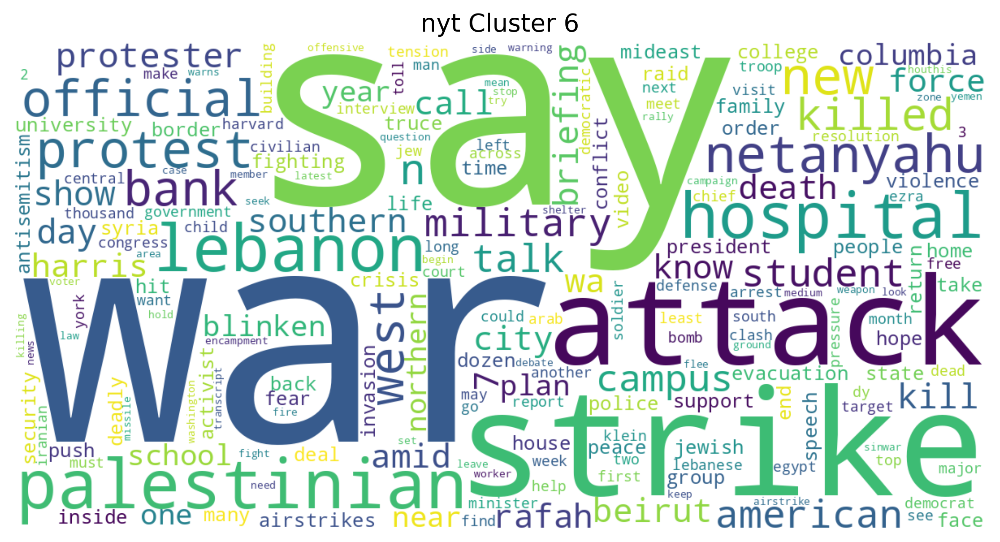

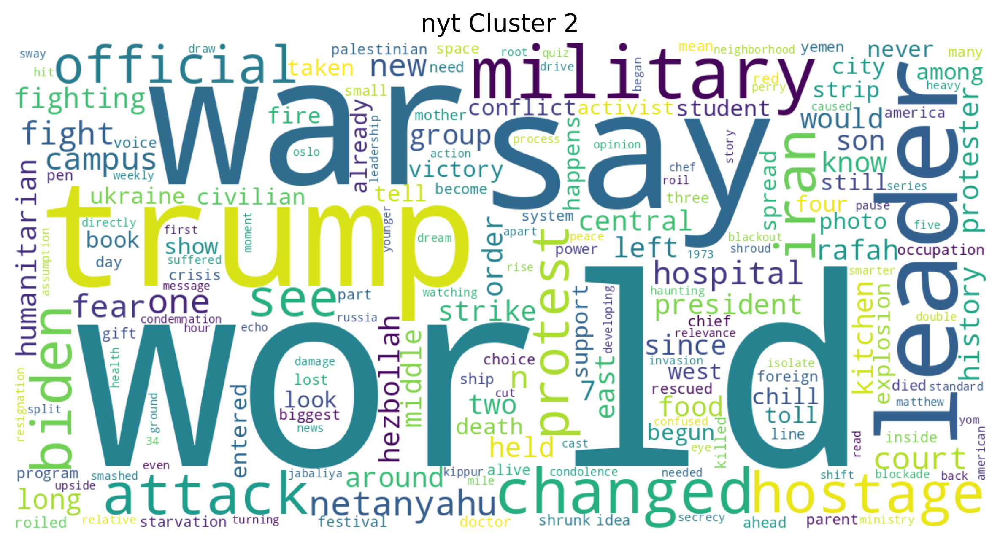

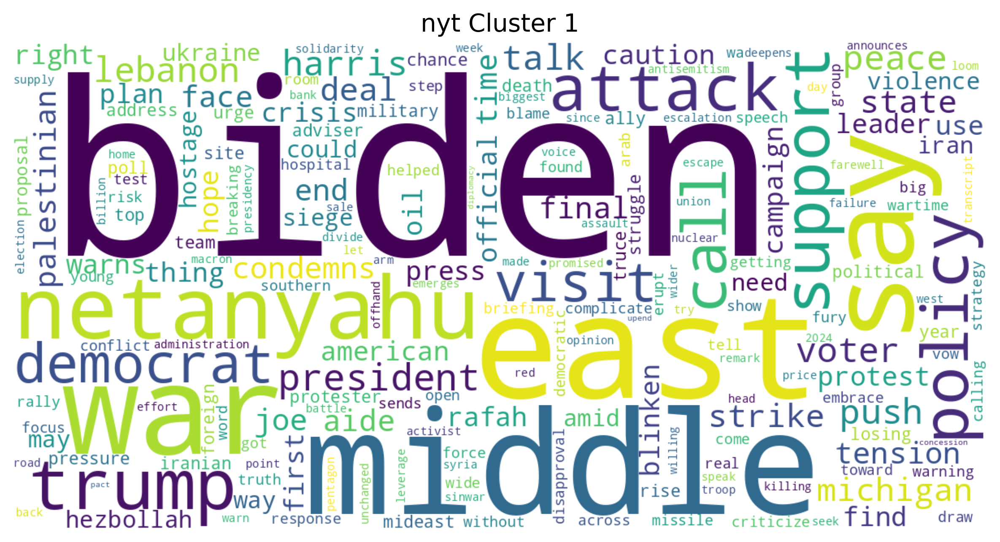

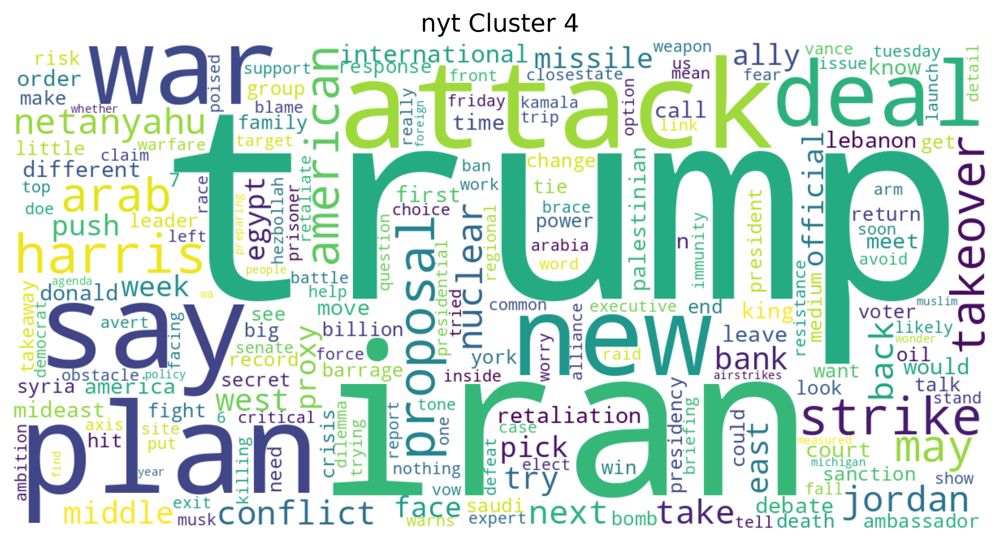

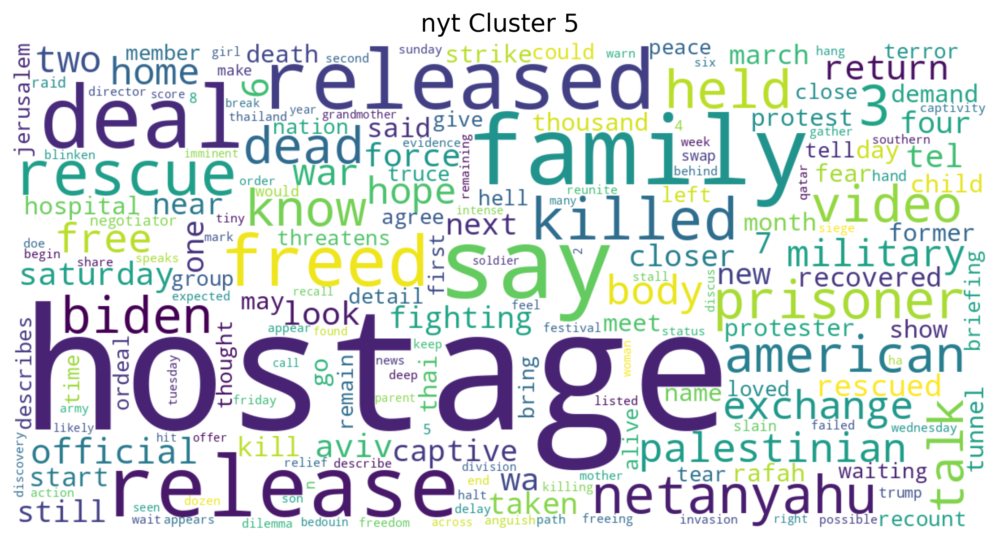

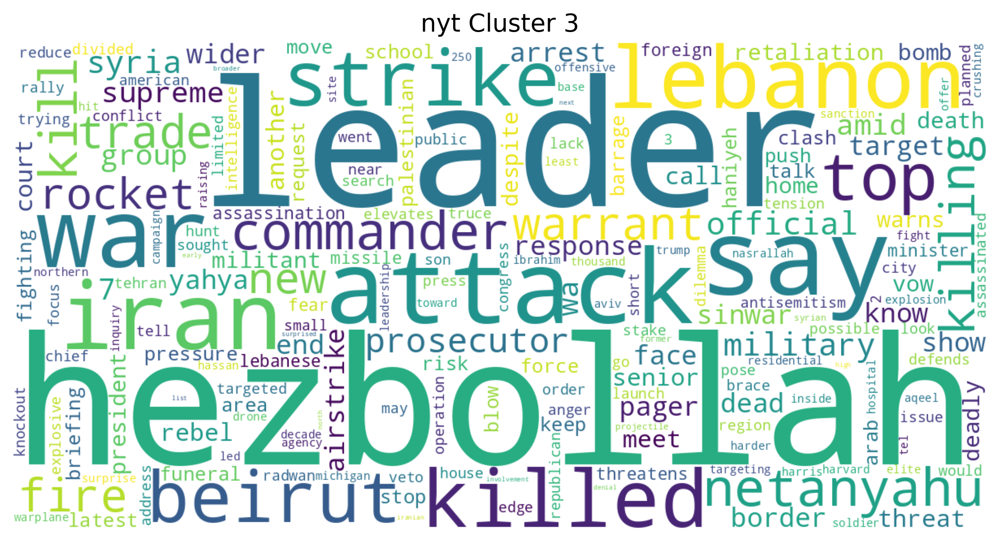

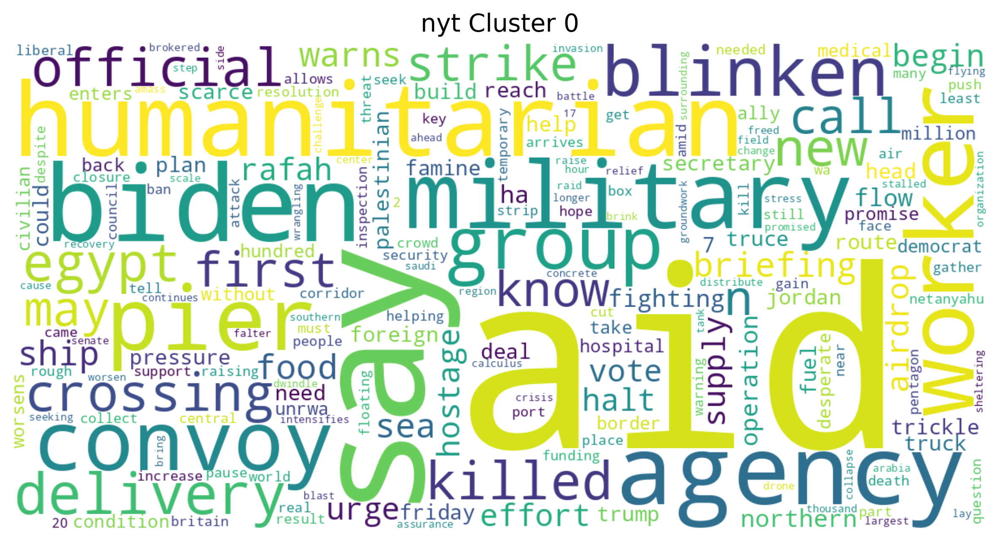

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from collections import Counter

clusters_nyt = nyt_df['cluster'].unique()

for cluster in clusters_nyt:
    # Create a new figure for each word cloud
    plt.figure(figsize=(10, 5), dpi=300)  # High-quality resolution (300 dpi)

    # Use 'cleaned_Headline' directly
    cluster_text = " ".join(nyt_df[nyt_df['cluster'] == cluster]['cleaned_Headline'].astype(str))

    word_freq = Counter(cluster_text.split())  # Count word frequencies

    # Remove unwanted words based on clusters
    if cluster == 2:
        word_freq.pop('ha', None)

    if cluster in {0, 3, 6}:
        word_freq.pop('u', None)

    # Generate word cloud
    wordcloud = WordCloud(width=1200, height=600, background_color='white').generate_from_frequencies(word_freq)

    # Display word cloud
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(f"nyt Cluster {cluster}", fontsize=14)

    # Save the word cloud image with high resolution
    filename = f"wordcloud_cluster_nyt_{cluster}.png"
    plt.savefig(filename, dpi=300, bbox_inches='tight')


In [ ]:
# Print 30 headlines per cluster for NYT (used to better understand clusters)

for cluster_num in range(7):  # 7 clusters
    cluster_headlines = nyt_df[nyt_df["cluster"] == cluster_num]
    print(f"Cluster {cluster_num}:")
    for i in range(min(30, len(cluster_headlines))):  # Print up to 30 headlines
        print(cluster_headlines.iloc[i]['Headline'])  # Access headline using iloc
    print("-" * 30)  # Separator between clusters

Cluster 0:
Humanitarian Aid Continues to Amass at Egypt’s Border as Crisis in Worsens
U.S. Says Didn’t Cause Hospital Blast, as Biden Promises Aid to
Deal Lays Groundwork for Aid to Reach Desperate ns, Officials Say
The U.N. Brokered a Deal to Bring Aid Into
A Deal for Aid Into , and More
Promised Aid to Is Stalled by Wrangling, as Conditions Worsen
First Convoy of Aid Enters Through Rafah Crossing
First Humanitarian Aid Reaches a Hard-Pressed
Intensifies Strikes on as Its Allies Call for More Palestinian Aid
With Fuel Scarce, U.N. Aid Group in Desperate May Scale Back
What to Know About UNRWA, the Largest Aid Organization in
i Tanks Raid Ahead of Invasion, While Aid Trickles In
The Battle Over Aid to
Saudi Arabia Begins Aid Effort for and Raises $17 Million in Hours
U.S. Drones Are Flying Over to Aid in Hostage Recovery, Officials Say
Jordan Airdrops Medical Aid to Its Field Hospital in
Senate Democrats Challenge Biden on , Seeking Assurances About Aid
Blinken Stresses Need for Humani

In order to better understand the clustering, we fed a list of 30 headlines in each cluster to ChatGPT. These are the labels for each cluster for the NYT, as analyzed by ChatGPT:
*  Cluster 0: Humanitarian Aid and Crisis Response
*  Cluster 1: Biden’s Leadership and U.S. Response
*  Cluster 2: Global Reactions and Historical Context
*  Cluster 3: Regional Actors and Hezbollah’s Role
*  Cluster 4: Iran’s Influence and U.S. Political Reactions
*  Cluster 5: Hostage Crisis and Negotiations
*  Cluster 6: Military Conflict and Broader War Context


# The Guardian Word Clouds

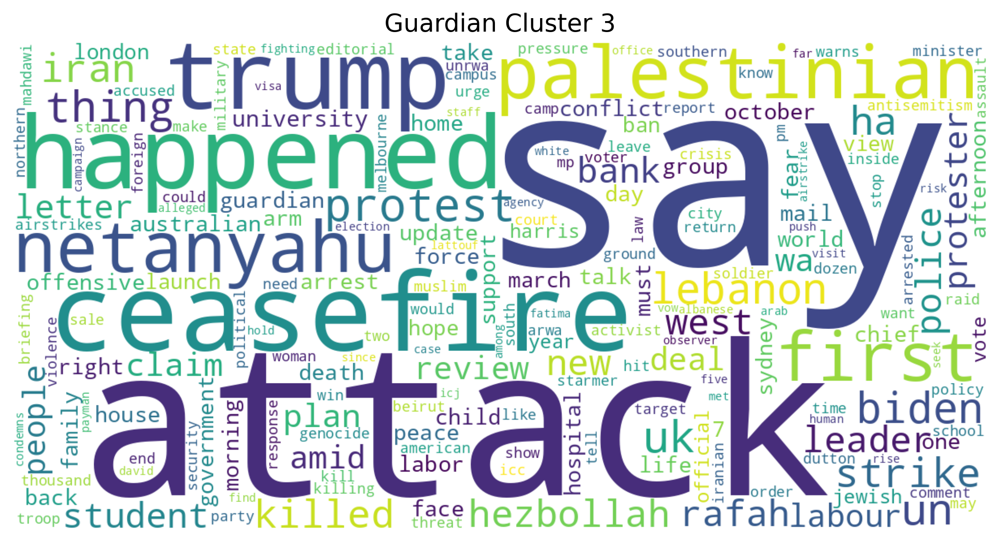

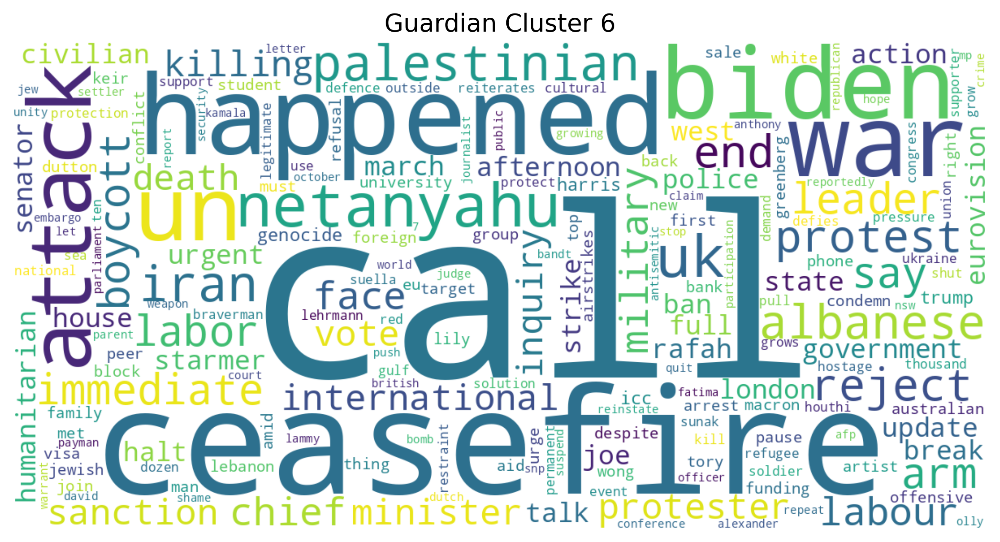

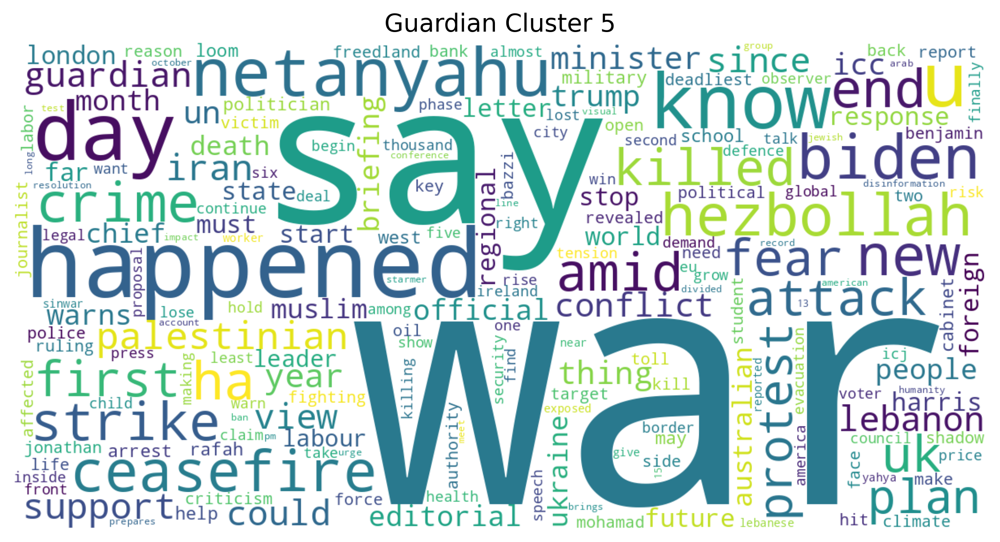

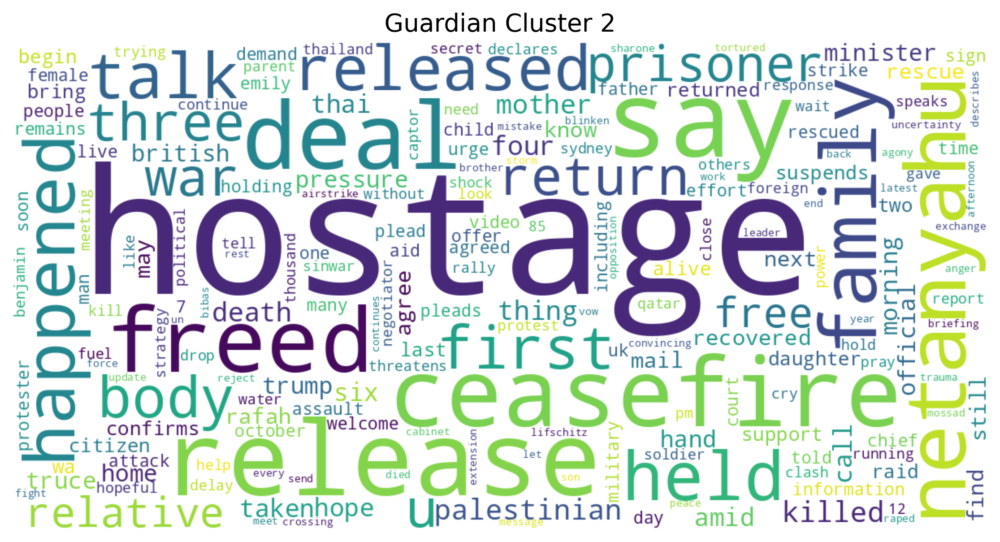

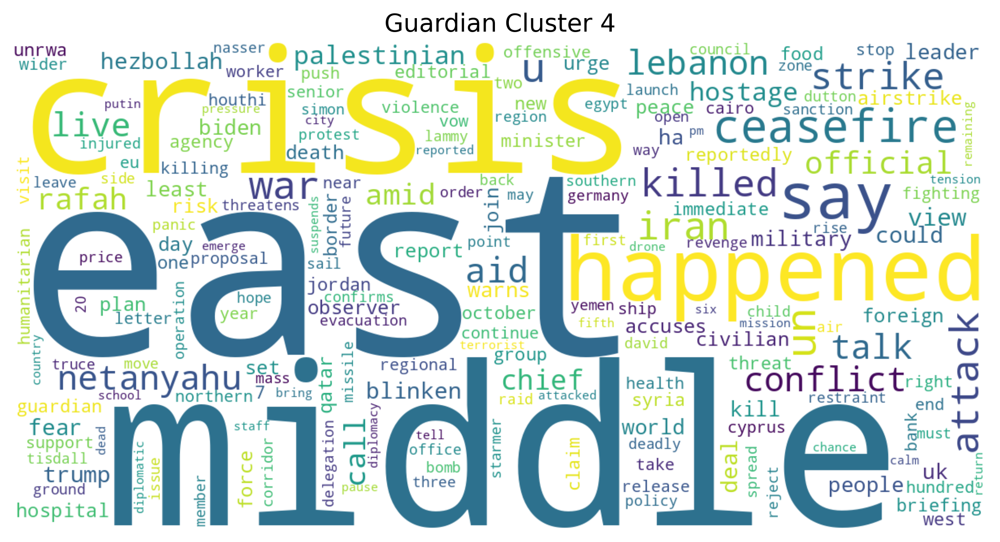

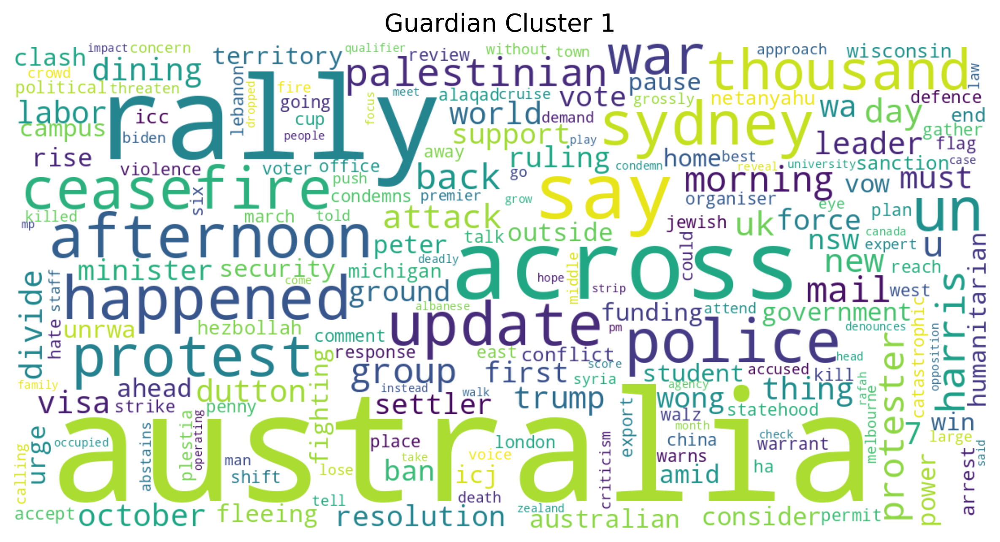

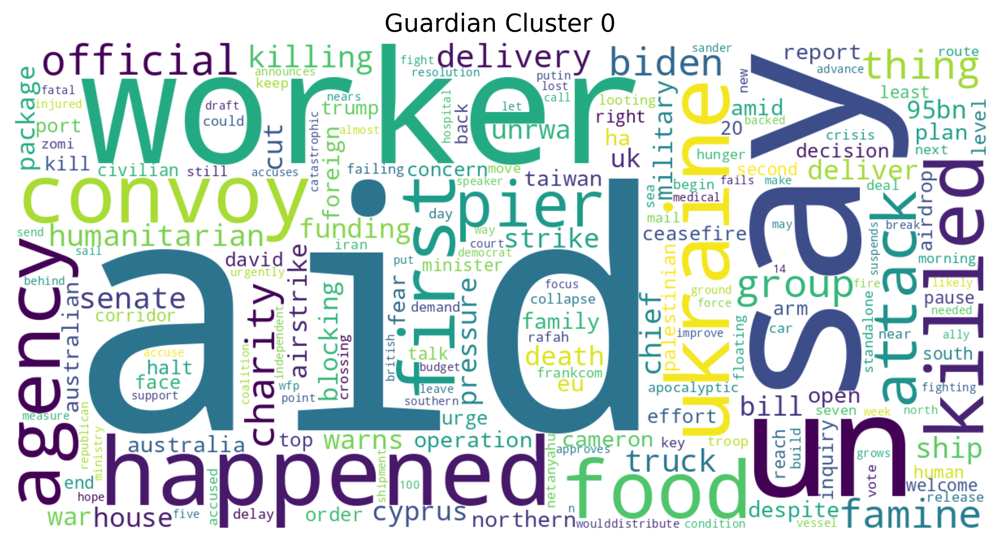

In [ ]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt
from collections import Counter

clusters_guardian = guardian_df['cluster'].unique()

for cluster in clusters_guardian:
    plt.figure(figsize=(10, 5), dpi=300)

    cluster_text = " ".join(guardian_df[guardian_df['cluster'] == cluster]['cleaned_Headline'].astype(str))

    word_freq = Counter(cluster_text.split())

    if cluster == 2:
        word_freq.pop('ha', None)

    if cluster in {0, 3, 6}:
        word_freq.pop('u', None)

    # Generate word cloud
    wordcloud = WordCloud(width=1200, height=600, background_color='white').generate_from_frequencies(word_freq)

    # Display word cloud
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(f"Guardian Cluster {cluster}", fontsize=14)

    # Save the word cloud image with high resolution
    filename = f"wordcloud_cluster_guardian_{cluster}.png"
    plt.savefig(filename, dpi=300, bbox_inches='tight')



In [ ]:
# Print headlines per cluster (Guardian)
for cluster_num in range(7):  # 7 clusters
    cluster_headlines = guardian_df[guardian_df["cluster"] == cluster_num]
    print(f"Cluster {cluster_num}:")
    for i in range(min(30, len(cluster_headlines))):  # Print up to 30 headlines
        print(cluster_headlines.iloc[i]['Headline'])  # Access headline using iloc
    print("-" * 30)  # Separator between clusters

Cluster 0:
EU aid to will ‘not be cancelled’ as decision reversed
US holds talks on aid corridor as continues airstrikes
Forget the lie about EU money for . For ordinary , the aid is a lifeline | Martin Konečný
Biden draws direct link between Putin and as he urges aid for and Ukraine
intensifies attacks on north as WFP says more aid urgently needed
Mitch McConnell backs Biden’s $106bn aid request for and Ukraine
- war: second convoy of as 14 aid trucks enters – as it happened
EU foreign ministers back humanitarian pause in - war to let in aid
UN warns aid operation will soon stop if fuel not let in
i forces advance in northern , as aid trickles in from the south
targets tunnels amid hopes more aid will reach civilians in
WHO says ‘almost impossible’ to bring aid into – as it happened
Leftist Democrats invoke human rights law in scrutiny of military aid
- war is deadliest ever for UN aid workers, with at least 88 killed
Aid charities urge Rishi Sunak to condemn ’s siege in
Democrats sup

In order to better understand the clustering, we fed a list of 30 headlines in each cluster to ChatGPT. These are the labels for each cluster for the Guardian, as analyzed by ChatGPT:
*  Cluster 0: Aid and Humanitarian Relief
*  Cluster 1: Protests, Rallies, and Public Sentiment
*  Cluster 2: Hostages and Prisoners
*  Cluster 3: Initial Attack and Military Response
*  Cluster 4: Diplomatic Responses & Geopolitics
*  Cluster 5: War Updates & General Conflict Coverage
*  Cluster 6: Calls for Ceasefire & Political Debates

# Overall Sentiment NYT vs. The Guardian

Use VADER to conduct sentiment analysis on headlines. Compare themes and keyword frequencies.

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 126.0/126.0 kB 8.9 MB/s eta 0:00:00


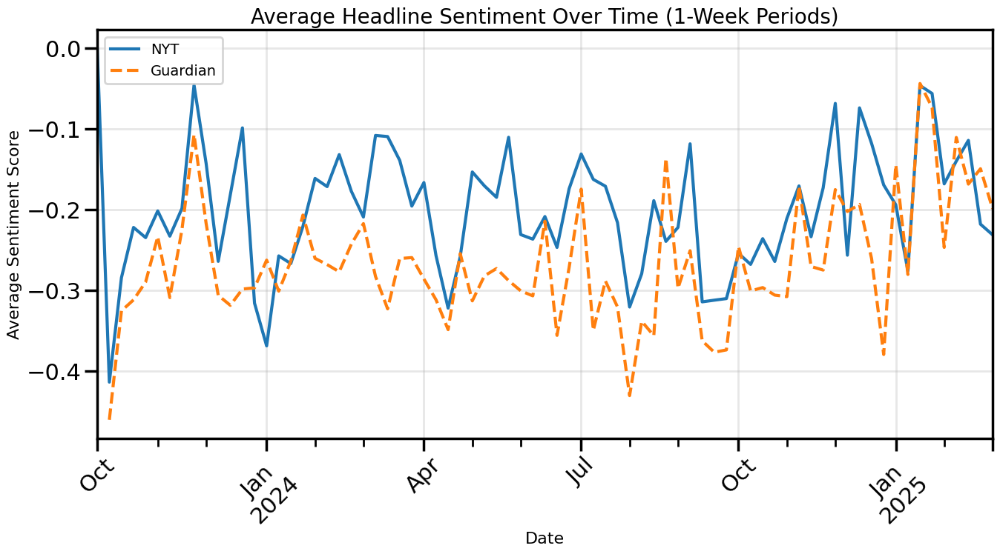

In [ ]:
!pip install vaderSentiment
import pandas as pd
import matplotlib.pyplot as plt
import os
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer

# Preprocessing data
def preprocess_headlines(df):
    # clean headlines
    df = df.copy()

    # Drop missing values
    df.dropna(subset=['Headline', 'Date'], inplace=True)

    # Convert 'Date' column to datetime format
    df['Date'] = pd.to_datetime(df['Date'])

    # Convert text to lowercase
    df['Headline'] = df['Headline'].str.lower()

    # Remove special characters
    df['Headline'] = df['Headline'].str.replace(r'[^a-zA-Z0-9\s]', '', regex=True)

    # Drop duplicate headlines
    df.drop_duplicates(subset=['Headline'], inplace=True)

    return df

# Apply preprocessing to Guardian and NYT
nyt_df = preprocess_headlines(nyt_df)
guardian_df = preprocess_headlines(guardian_df)

# Sentiment analysis
analyzer = SentimentIntensityAnalyzer()

# function to return VADER sentiment score
def get_sentiment_score(headline):
    return analyzer.polarity_scores(headline)['compound']

# Apply sentiment analysis
nyt_df['Sentiment'] = nyt_df['Headline'].apply(get_sentiment_score)
guardian_df['Sentiment'] = guardian_df['Headline'].apply(get_sentiment_score)

# Group by 2-week periods, compute average sentiment
nyt_sentiment_trend = nyt_df.groupby(pd.Grouper(key='Date', freq='W'))['Sentiment'].mean()
guardian_sentiment_trend = guardian_df.groupby(pd.Grouper(key='Date', freq='W'))['Sentiment'].mean()

# Plot results
sns.set_context('poster')
plt.figure(figsize=(14, 8))
nyt_sentiment_trend.plot(label='NYT', linestyle='-')
guardian_sentiment_trend.plot(label='Guardian', linestyle='--')

# Format the plot
plt.title('Average Headline Sentiment Over Time (1-Week Periods)', fontsize=20)
plt.xlabel('Date', fontsize=16)
plt.ylabel('Average Sentiment Score', fontsize=16)
plt.xticks(rotation=45)
plt.legend(fontsize=14)
plt.grid(alpha=0.3)

# Save figure
plt.tight_layout()
output_dir = "output"  #
os.makedirs(output_dir, exist_ok=True)
output_path = os.path.join(output_dir, "sentiment_trend.png")

plt.savefig(output_path, dpi=300)
plt.show()

# Keyword frequency

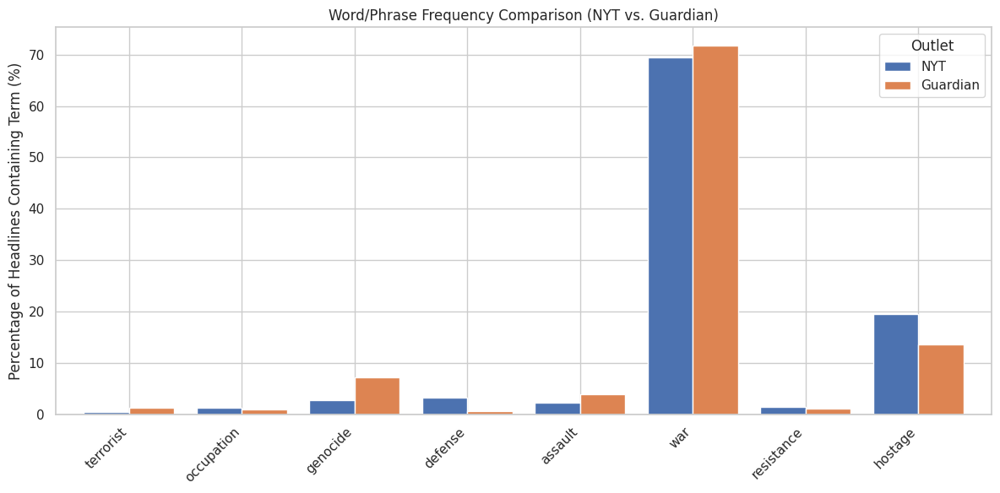

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Define key framing terms to analyze
keywords = ['terrorist', 'occupation', 'genocide', 'defense', 'assault', 'war', 'resistance', 'hostage']

# Function to count keyword occurences
def count_keywords(df, keywords):
    counts = {}
    for word in keywords:
        # Count how many headlines contain the word (case-insensitive)
        counts[word] = df['Headline'].str.contains(fr'\b{word}\b', case=False, regex=True).sum()
    return counts

# Count occurrences in each DataFrame
nyt_counts = count_keywords(nyt_df, keywords)
guardian_counts = count_keywords(guardian_df, keywords)

# Combine into one DataFrame
freq_df = pd.DataFrame([nyt_counts, guardian_counts], index=['NYT', 'Guardian']).T

# Normalize to percentage
freq_df_percent = freq_df.div(freq_df.sum(axis=0), axis=1) * 100

# Plot
freq_df_percent.plot(kind='bar', figsize=(12, 6), width=0.8)
plt.title('Word/Phrase Frequency Comparison (NYT vs. Guardian)')
plt.ylabel('Percentage of Headlines Containing Term (%)')
plt.xticks(rotation=45, ha='right')
plt.legend(title='Outlet')
plt.tight_layout()
plt.show()
